In [494]:
!pip install osmnx

## Task 1-3: Fix and improve the code and visualization

In [495]:
#import nessesary libraries 
import random
import numpy as np
from scipy import stats

import osmnx as ox
import networkx as nx

import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

from IPython.display import display, clear_output, Image, HTML
import imageio.v2 as imageio
import os


In [496]:
class Car:
    """
    creates a car object
    """
    def __init__(self, start, destination):
        """
        Parameters:
        current_location: 
            the starting node of the car's journey.
            It is updated as a car moves.
        destination: 
            the destination node the car is heading towards.
        path (list): 
            represents the path the car will follow from its current location to the destination.
            it is initially an empty list and is populated when the path is determined during the simulation.
        location_on_edge (float): 
            the distance traveled by the car on the current road edge, initially set to 0.
        edge (tuple): 
            represents the current road edge as (current_location, next_node, key).
            it is updated as a car moves.
        """
        self.current_location = start
        self.destination = destination
        self.path = []
        self.location_on_edge = 0
        self.edge = (0,0,0)
        self.jam = False 

In [530]:
        
class TrafficSimulator:
    def __init__(self, address, num_cars=1000, num_steps=10, min_car_limit = 10):
        """
        Initialize a TrafficSimulator object.

        address (str): 
            the address used to fetch the road network
        G (networkx.Graph): 
            the road network graph created from the specified address using OSMnx.
        nodes (list): 
            the list of all the nodes of the network generated
        num_cars (int, optional): 
            total number of cars in the simulation. Default is 1000.
        num_steps (int, optional): 
            total number of simulation steps. Default is 10.
        min_car_limit (int, optional): 
            minimum limit of cars; restocking occurs if the count falls below this limit. Default is 10.
        road_lengths (dict): 
            the lengths of each road edge in the network.
        max_speeds (dict): 
            maximum speeds for each road edge.
        speeds (dict): 
            current speeds for each road edge based on traffic density.
            it is updated during the simulation based on traffic density and maximum speeds.
        road_density (dict): 
            traffic density for each road edge.
        car_count (dict): 
            the count of cars on each road edge.
        cars (list): 
            contains instances of the Car class representing individual cars in the simulation.
            it is initially an empty list and is populated during the simulation.
        """
        self.address = address
        self.G = ox.graph_from_address(self.address, dist=1000, network_type='drive')
        self.nodes = list(self.G.nodes()) 
        
        self.num_cars = num_cars
        self.num_steps = num_steps
        self.min_car_limit = min_car_limit
        
        self.road_lengths = {}
        self.max_speeds = {} 
        self.speeds = {}
        self.road_density = {}
        self.car_count = {}
        
        self.cars = []
        
    

    def edge_metrics(self): 
        """
        Calculate and update network edge properties based on the current state of the simulation.

        This method computes edge metrics, including road lengths, maximum speeds,
        car counts, road density, and car speeds. It updates the relevant attributes
        in the simulation. Calculated the travel time that is used as a weight in determining path

        """
        # bulk assignment using dictionary comprehensions
        self.road_lengths = {(u, v, k): float(data['length']) for u, v, k, data in self.G.edges(data=True, keys=True)}
        self.max_speeds = {(u, v, k): float(data['maxspeed'][0].split()[0]) / 60 if data.get('maxspeed') else 30 for u, v, k, data in self.G.edges(data=True, keys=True)}

        # initialize dictionaries for car count and road density 
        self.car_count = {(u, v, k): 0 for u, v, k in self.G.edges(keys=True)}
        self.road_density = {(u, v, k): 0 for u, v, k in self.G.edges(keys=True)}

        for car in self.cars:
            #calculate the number of cars on the edge
            if car.path and len(car.path) > 1:
                self.car_count[car.edge] += 1

        for edge in self.car_count:
            #get the number of cars on the edge
            count = self.car_count[edge]
            #calculate the density considering each car needs 3 meters of space
            self.road_density[edge] = count * 3 / self.road_lengths[edge]

        for u, v, k, data in self.G.edges(data=True, keys=True):
            #calculate the speed as a linear function of density
            slope = -self.max_speeds[(u, v, k)]
            intercept = self.max_speeds[(u, v, k)]
            road_density = self.road_density[(u, v, k)]
            s = slope * road_density + intercept
            #update speeds using bulk assignment
            self.speeds[(u, v, k)] = np.maximum(0.001, np.minimum(self.max_speeds[(u, v, k)], s))

            #update travel time based on the current speed at the edge
            data["travel_time"] = data["length"] / (float(self.speeds[(u, v, k)]) * 1000 / 60)
                        
    
    def generate_one_car(self):
        """
        generate a new Car instance 

        Ensured valid starting and destination nodes with existing connecting path
        initializes car instance with the selected starting and destination nodes.
        determined the shortes path based on the travel time using 'determine_path' method.
        sets initial edge information based on the determined path.
        
        output: 
            car (Car class object): a newly generated Car instance
        """
        #choose random start and end nodes 
        start_node, destination_node = random.choice(self.nodes), random.choice(self.nodes)
        #ensure the validity of the start and end nodes
        while start_node == destination_node or not nx.has_path(self.G, start_node, destination_node):
            start_node, destination_node = random.choice(self.nodes), random.choice(self.nodes)

        car = Car(start_node, destination_node)
        self.determine_path(car)
        car.edge = (car.path[0], car.path[1], 0)
        return car 
               
        
    
    def determine_path(self, car):
        """
        Determine the path for a given car based on the current state of the simulation.

        Input:
            car (Car class intance): the car for which the path needs to be determined.
        
        Updates edge metrics using 'edge_metrics'. Then if a car has no path, it determines the path for the
        specified car, considering the updates in 'edge_metrics' 'travel_time' as the weight.
        The determined path is assigned to the 'path' attribute of the car.

        """
        self.edge_metrics()
        car.path = nx.shortest_path(self.G, car.current_location, car.destination, weight="travel_time")
            
    def move_cars_recursive(self, car): 
        """
        Recursive function to move a car along its path, considering edge conditions and potential traffic jams.
        
        Input:
            car (Car class intance): the car for which the path needs to be determined.

        Checks if the car has moved beyond the current edge while having a valid path with more than 3 nodes remaining.
        If a traffic jam is detected on the next edge, 
        the car remains stationary (even thought there is no jam on its node). 
        Otherwise, the car progresses to the next node, 
        updates its current location and edge information,
        and recursively calls itself to continue the movement along the path. 
        If the car reaches its destination, the jam flag is set to False.
        """
        if car.location_on_edge - self.road_lengths[car.edge] > 0 and len(car.path) > 3:
            #check if there is jam on the next node
            if self.road_density[(car.path[1], car.path[2], 0)] < 0.9:
                remained_length = car.location_on_edge - self.road_lengths[car.edge]
                car.path.pop(0)  #move the car
                car.current_location = car.path[0]
                if car.current_location != car.destination:
                    car.edge = (car.path[0], car.path[1], 0)
                    #add the rest of the distance moved to the next edge, limit to the edge length
                    car.location_on_edge = remained_length
                    car.jam = False 
                    self.move_cars_recursive(car)
            else:
                car.jam = True 

                                        
        
    def move_cars(self):
        """
        Models one step of car movement in the traffic simulation.

        Simulates the movement of cars for one time step. 
        Filters out cars that have reached their destination, updating the car list accordingly.
        Restocks cars if the current count falls below the specified minimum limit 
        Updates edge metrics to reflect the current state of the simulation, 
        considering factors such as traffic density and car speeds.
        Iterates over each car, updating its position on the current edge, adjusting speeds, 
        and calling recursing movement function.
        """
        #use list comprehension to filter out cars that reached their destination
        self.cars = [car for car in self.cars if car.current_location != car.destination]
        
        #restocking cars if the number below the min limit 
        cars_to_add = max(0, self.min_car_limit - len(self.cars))
        self.cars.extend([self.generate_one_car() for _ in range(cars_to_add)])
        self.edge_metrics()
        for car in self.cars:
            #update path if needed
            self.determine_path(car)
            if not car.jam:
                #random speed change 
                self.speeds[car.edge] = self.speeds[car.edge] + random.uniform(0,3)
                car.location_on_edge += (self.speeds[car.edge])/1000*60 * self.road_lengths[car.edge]
            self.move_cars_recursive(car)

        
            
#________________FOR_VISUALIZATION___________________

    
    def plot_network_with_traffic(self, show_figure = True):   
        """
        Plots the road network with number of cars on edges. 
        Assign the width of the edges based on the log function of the number of card on the edge 
        Assign the colors based on the car density. 
        red -> highest number of cars, green -> lowest number of cars 

        Parameters:
        show_figure (bool): whether to display the figure. Default is True.

        Output:
        fig (matplotlib.figure.Figure): the created figure.
        ax (matplotlib.axes._axes.Axes): the axes of the figure.
        """
        edge_colors = []
        edge_widths = []

        self.edge_metrics()
        densities = self.car_count
        max_density = max(densities.values())
        
        #set up a color map and normalization for the colorbar        
        colors = ['lightgreen', 'yellow', 'red']
        cmap = mcolors.LinearSegmentedColormap.from_list('cmap', colors, N=256)
        norm_density = mcolors.Normalize(vmin=0, vmax=max_density)

        for u, v, k, data in self.G.edges(keys=True, data=True):
            count = self.car_count.get((u, v, k), 0.001)
            density = norm_density(count)

            #assign color based on the colormap
            edge_color = cmap(density) 
            edge_colors.append(edge_color)
        
            #use scaling for edge widths
            edge_width = np.log(count) + 1 if count > 0 else 1
            edge_widths.append(edge_width)
            
        fig, ax = ox.plot_graph(self.G, figsize=(10, 10), edge_color=edge_colors, edge_linewidth=edge_widths, show=False)
        #create a colorbar using the specified axes
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm_density)
        sm.set_array([])  #dummy empty array for the color mapping
        cbar = plt.colorbar(sm, ax=ax, label='Number of cars', fraction=0.0455, pad=0.02)

        if show_figure: 
            ax.set_title('Road Network with Traffic Density')
            plt.show()
        return fig, ax
    

In [531]:
def create_gif(frames, gif_path='animation.gif', duration=0.5):
    """
    Creates a GIF animation from a list of frames.

    Input:
        frames (list): list of file paths or image arrays representing frames.
        gif_path (str): path to save the GIF file. Default is 'animation.gif'.
        duration (float): duration (in seconds) of each frame in the GIF. Default is 0.5.

    Output:
        gif_path (str): Path to the created GIF file.
    """
    images = [imageio.imread(frame) for frame in frames]
    imageio.mimsave(gif_path, images, duration=duration)
    return gif_path


def display_gif(gif_path):
    """
    Displays a GIF file in the Jupyter Notebook environment.

    Input:
        gif_path (str): path to the GIF file.

    """
    with open(gif_path, "rb") as f:
        display(Image(data=f.read(), format="png"))

        
def simulate_traffic(address, num_cars, num_steps, min_car_limit, gif=True, update_frequency=1):
    """
    Simulates traffic on a road network and visualizes the results.

    Input:
        address (str): address used to fetch the road network.
        num_cars (int): total number of cars in the simulation.
        num_steps (int): total number of simulation steps.
        min_car_limit (int): minimum limit of cars; restocking occurs if the count falls below this limit.
        gif (bool): whether to create and display GIF animations. Default is True.
        update_frequency (int): frequency of updating the GIF animations. Default is 1.
    """
    sim = TrafficSimulator(address, num_cars = num_cars, num_steps = num_steps, min_car_limit = min_car_limit)
    sim.cars = [sim.generate_one_car() for _ in range(sim.num_cars)]
    
    frames_traffic = []  # To store frames for the traffic visualization
    frames_distribution = []  # To store frames for the distribution plots

    for step in range(sim.num_steps):
        sim.move_cars()

        if gif and step % update_frequency == 0:
            # Plot the current state of the simulation for traffic
            fig_traffic, ax_traffic = sim.plot_network_with_traffic(show_figure=False)
            plt.title(f'Step {step + 1} - Traffic')
            frame_traffic_path = f"frame_traffic_{step}.png"
            fig_traffic.savefig(frame_traffic_path, bbox_inches='tight', pad_inches=0.1)
            plt.close(fig_traffic)
            frames_traffic.append(frame_traffic_path)

            # Plot the distribution and save the frame
            fig_dist = plt.figure(figsize=(6, 6))
            densities = sim.car_count.values()
            plt.hist(densities, bins=50, edgecolor='black')
            plt.xlabel('Edge car count distribution')
            plt.ylabel('Frequency')
            plt.title(f'Step {step + 1} - Distribution of the cars across edges')
            frame_dist_path = f"frame_distribution_{step}.png"
            fig_dist.savefig(frame_dist_path, bbox_inches='tight', pad_inches=0.1)
            plt.close(fig_dist)
            frames_distribution.append(frame_dist_path)

    if gif:
        gif_path_traffic = create_gif(frames_traffic, gif_path='animation_traffic.gif')
        display_gif(gif_path_traffic)

        gif_path_distribution = create_gif(frames_distribution, gif_path='animation_distribution.gif')
        display_gif(gif_path_distribution)

        # Clean up the temporary frame images
        for frame_path in frames_traffic + frames_distribution:
            os.remove(frame_path)
        

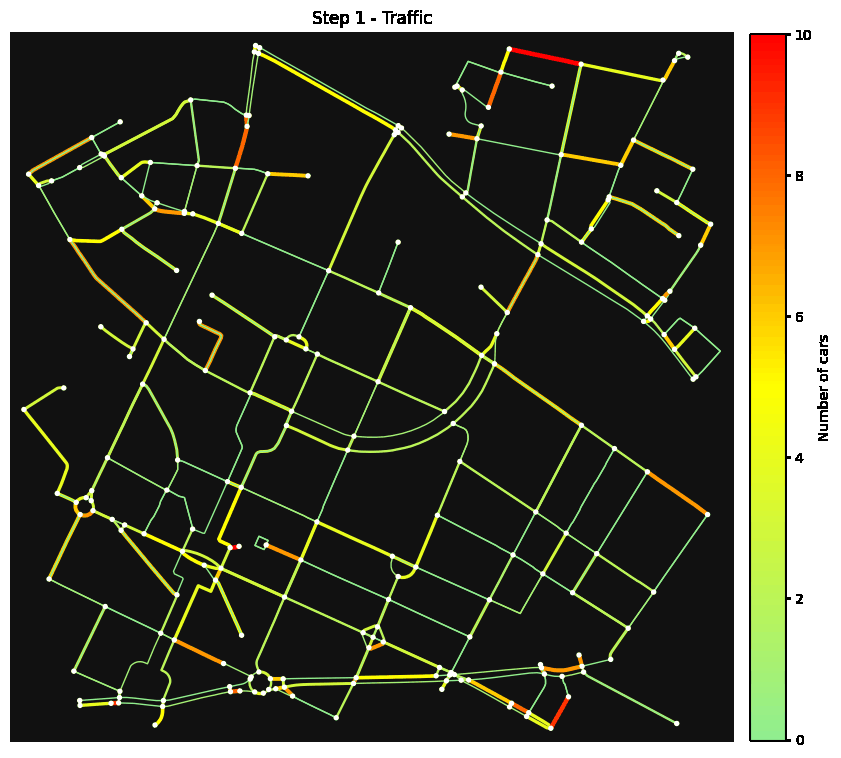

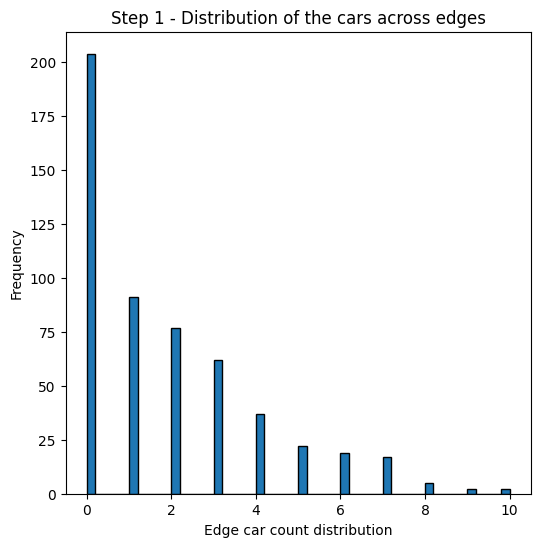

In [535]:
simulate_traffic(address = 'Adalbertstraße 58, Berlin, Germany', 
                 num_cars = 1000, 
                 num_steps = 100, 
                 min_car_limit = 10, 
                 gif=True, 
                 update_frequency = 1)

## Location Based simulation

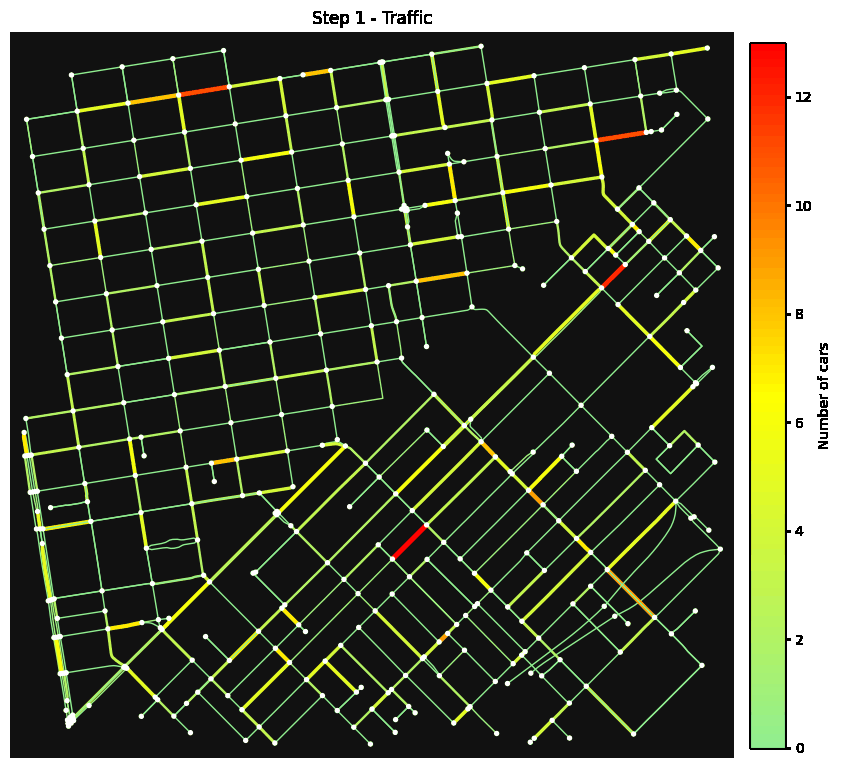

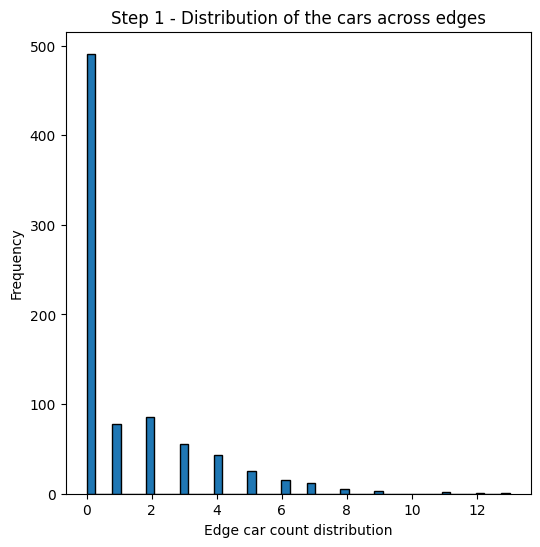

In [536]:
simulate_traffic(address = '16 Turk, San Francisco, USA', 
                 num_cars = 1000, 
                 num_steps = 100, 
                 min_car_limit = 10, 
                 gif=True, 
                 update_frequency = 1)


## Theorethical Analysis 

In [76]:
def theoretical_analysis(address):
     """
    Performs theoretical network analysis on a road network.

    Input:
        address (str): The address used for the road network.

    Output:
        degree_centrality (dict): dictionary of degree centrality values for each node.
        edge_betweenness_centrality (dict): dictionary of edge betweenness centrality values for each edge.
        closeness_centrality (dict): dictionary of closeness centrality values for each node.
    """
    g = ox.graph_from_address(address, dist=1000, network_type='drive') 
    degree_centrality = nx.degree_centrality(g)
    edge_betweenness_centrality = nx.edge_betweenness_centrality(g)
    closeness_centrality = nx.closeness_centrality(g)
    return degree_centrality, edge_betweenness_centrality, closeness_centrality

In [77]:
def confidence_interval(data):
    """
    Calculates the mean and confidence interval for a given dataset.

    Input:
        data(list): the dataset for which the mean and confidence interval are calculated.

    Output:
        mean_data (float): the mean of the dataset.
        lower_bound (float): the lower bound of the confidence interval.
        upper_bound (float): the upper bound of the confidence interval.
    """
    mean_data = np.mean(data)
    std_dev_data = np.std(data, ddof=1)  
    #calculate the standard error of the mean (SEM)
    sem = std_dev_data / np.sqrt(len(data))
    confidence_level = 0.95
    #calculate the margin of error
    margin_of_error = stats.t.ppf((1 + confidence_level) / 2.0, len(data) - 1) * sem
    lower_bound = mean_data - margin_of_error
    upper_bound = mean_data + margin_of_error
    return mean_data, lower_bound, upper_bound

In [81]:
def plot_metrics(address, city):
    """
    Plots histograms and statistics for degree centrality, edge betweenness centrality, and closeness centrality.

    Input:
        address (str): The address for which the road network is extracted.
        city (str): The city name for labeling the plots.

    """
    degree_centrality, edge_betweenness_centrality, closeness_centrality = theoretical_analysis(address)
    mean_data, lower_bound, upper_bound = confidence_interval(list(degree_centrality.values()))
    print(f"Mean: {mean_data}")
    print(f"95% Confidence Interval: ({lower_bound}, {upper_bound})")
    plt.hist(degree_centrality.values(), bins = 20, color = 'lightcoral', edgecolor='black')
    plt.title(f'Degree centrality ({city})')
    plt.xlabel('Degree centrality measure')
    plt.ylabel('Frequency')
    plt.axvline(mean_data, color='blue', linestyle='dashed', linewidth=2, label='Mean')
    plt.axvline(lower_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Lower Bound')
    plt.axvline(upper_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Upper Bound')
    plt.legend()
    plt.show()

    plt.figure()
    mean_data, lower_bound, upper_bound = confidence_interval(list(edge_betweenness_centrality.values()))
    print(f"Mean: {mean_data}")
    print(f"95% Confidence Interval: ({lower_bound}, {upper_bound})")
    plt.hist(edge_betweenness_centrality.values(),  bins = 20, color = 'cornflowerblue', edgecolor='black')
    plt.title(f'Edge betweeness centrality ({city})')
    plt.xlabel('Betweeness centrality measure')
    plt.ylabel('Frequency')
    plt.axvline(mean_data, color='blue', linestyle='dashed', linewidth=2, label='Mean')
    plt.axvline(lower_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Lower Bound')
    plt.axvline(upper_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Upper Bound')
    plt.legend()
    plt.show()

    plt.figure()
    mean_data, lower_bound, upper_bound = confidence_interval(list(closeness_centrality.values()))
    print(f"Mean: {mean_data}")
    print(f"95% Confidence Interval: ({lower_bound}, {upper_bound})")
    plt.hist(closeness_centrality.values(),  bins = 20, color = 'mediumpurple', edgecolor='black')
    plt.title(f'Closeness centrality ({city})')
    plt.xlabel('Closeness centrality measure')
    plt.ylabel('Frequency')
    plt.axvline(mean_data, color='blue', linestyle='dashed', linewidth=2, label='Mean')
    plt.axvline(lower_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Lower Bound')
    plt.axvline(upper_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Upper Bound')
    plt.legend()
    plt.show()

Mean: 0.021160275319567354
95% Confidence Interval: (0.02013336802282021, 0.0221871826163145)


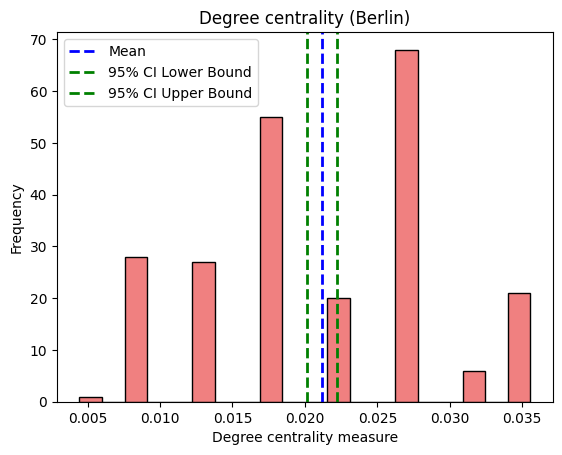

Mean: 0.019914830776428957
95% Confidence Interval: (0.018095210820364478, 0.021734450732493436)


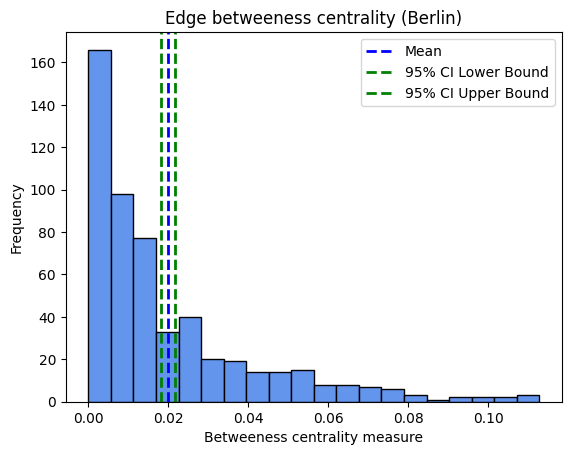

Mean: 0.0954375469127515
95% Confidence Interval: (0.09307599040249048, 0.09779910342301251)


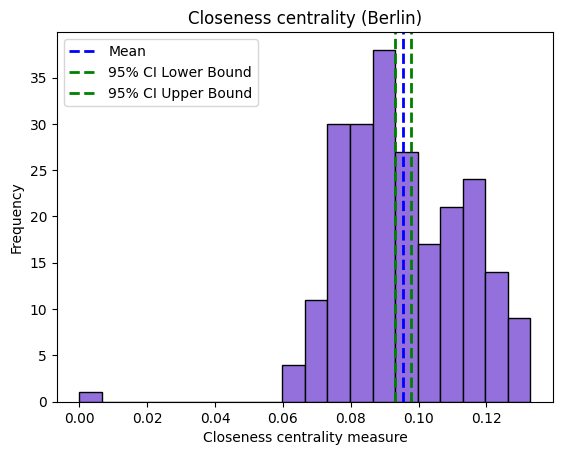

In [82]:
address = 'Adalbertstraße 58, Berlin, Germany'
city = 'Berlin'
plot_metrics(address, city)

Mean: 0.010606532689411642
95% Confidence Interval: (0.010233504858515749, 0.010979560520307536)


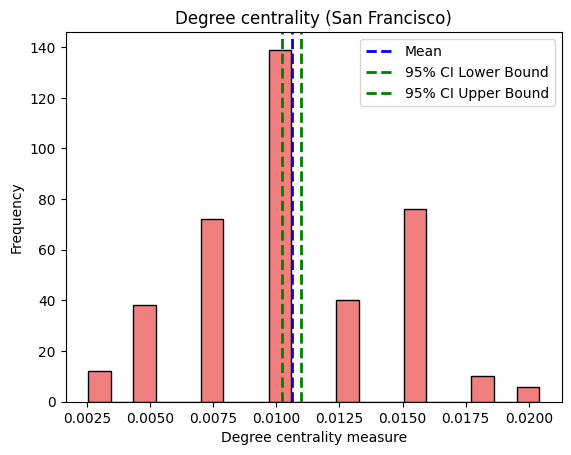

Mean: 0.015185730360239064
95% Confidence Interval: (0.014113152756324007, 0.01625830796415412)


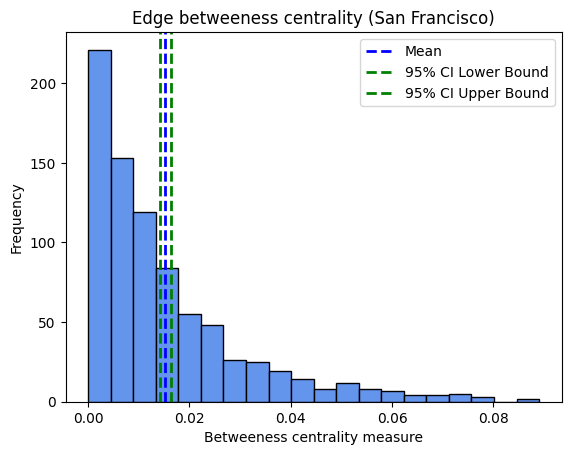

Mean: 0.07053398849935151
95% Confidence Interval: (0.068806871757923, 0.07226110524078003)


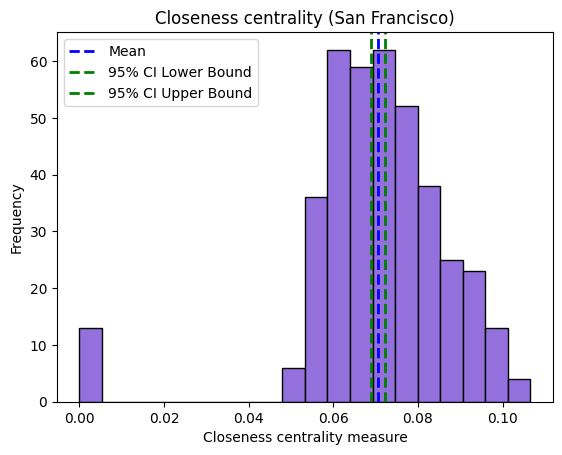

In [83]:
address = '16 Turk, San Francisco, USA'
city = 'San Francisco'
plot_metrics(address, city)

In [413]:
def plot_network_with_results(g, values, show_figure=True):
        """
        Plots the road network with edge betweenness centrality.

        Input:
            show_figure (bool): whether to display the figure. Default is True.

        Output:
            fig (matplotlib.figure.Figure): the created figure.
            ax (matplotlib.axes._axes.Axes): the axes of the figure.
        """
        edge_colors = []

        max_values = max(values.values())

        # Set up a color map and normalization for the color bar
        colors = ['lightgreen', 'yellow', 'red']
        cmap = mcolors.LinearSegmentedColormap.from_list('cmap', colors, N=256)
        norm = plt.Normalize(0, max_values)

        for u, v, k, data in g.edges(keys=True, data=True):
            v = values.get((u, v, k), 0)

            # Assign color based on the colormap
            edge_color = cmap(norm(v))
            edge_colors.append(edge_color)

        fig, ax = ox.plot_graph(g, figsize=(10, 10), edge_color=edge_colors, show=False)

        # Create a colorbar using the specified axes
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])  # Dummy empty array for the color mapping
        cbar = plt.colorbar(sm, ax=ax, label='Traffic Density', fraction=0.0455, pad=0.02)

        if show_figure:
            ax.set_title('Road Network with Traffic Density')
            plt.show()
        return fig, ax
    
    

def streets_with_highest_density(g, values, n_streets=20):
    """
    Returns the names of streets with the highest edge betweenness centrality.

    Input:
        g (networkx.Graph): the road network graph.
        n_streets (int): the number of streets to return. Default is 5.

    Output:
        street_names (list): a list of street names with the highest edge betweenness centrality.
    """
    # Find the top n streets with highest betweenness centrality
    top_streets = sorted(values, key=values.get, reverse=True)[:n_streets]

    street_names = []
    for edge in top_streets:
        u, v, k = edge
        street_data = g.get_edge_data(u, v, k)
        if street_data and 'name' in street_data:
            street_names.append(street_data['name'])
        else:
            street_names.append(f"Unnamed street ({u}, {v})")

    return street_names
    


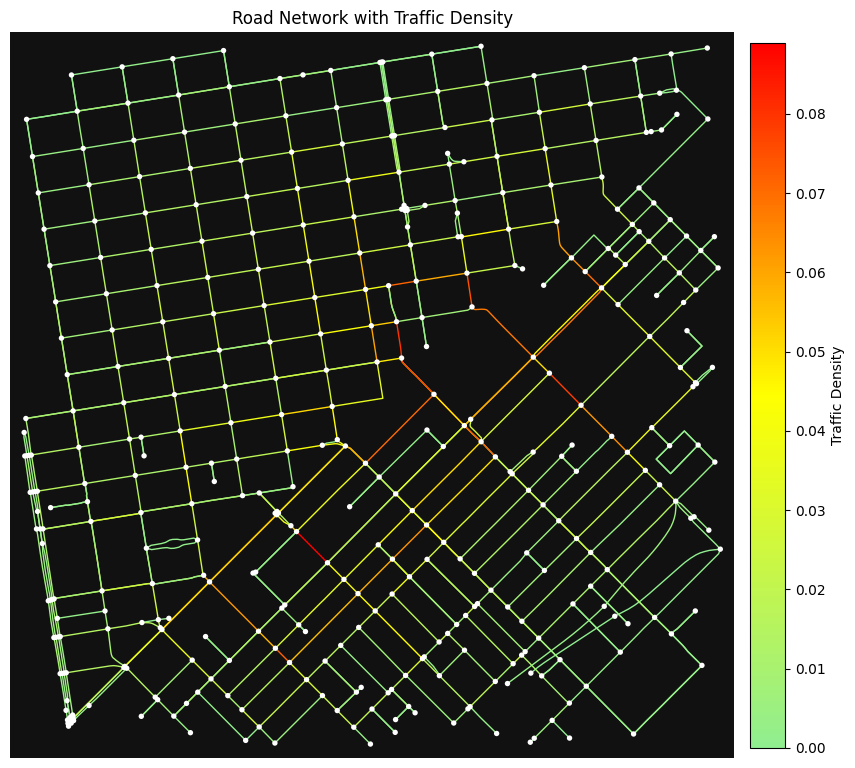

In [418]:
address = '16 Turk, San Francisco, USA'
g_sf = ox.graph_from_address(address, dist=1000, network_type='drive') 
betweenness_values_sf = nx.edge_betweenness_centrality(g_sf)
plot_network_with_results(g_sf, betweenness_values_sf)
theor_str_sf = streets_with_highest_density(g_sf, betweenness_values_sf)

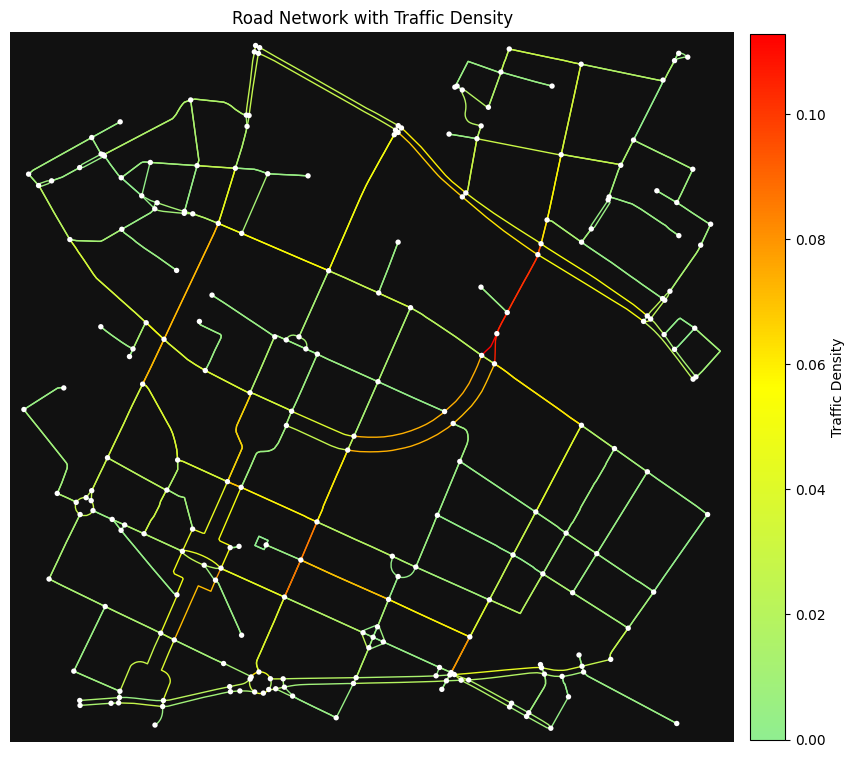

In [416]:
address = 'Adalbertstraße 58, Berlin, Germany'
g_berlin = ox.graph_from_address(address, dist=1000, network_type='drive') 
betweenness_values_b = nx.edge_betweenness_centrality(g_berlin)
plot_network_with_results(g_berlin, betweenness_values_b)
theor_str_berlin = streets_with_highest_density(g_berlin, betweenness_values_b)


## Empirical Analysis

In [420]:
def traffic_empirical(address, num_cars, num_steps, min_car_limit):
    """
    Simulates traffic and returns empirical traffic density during the simulation.

    Input:
        address (str): The address for which the road network is extracted.
        num_cars (int): The initial number of cars in the simulation.
        num_steps (int): The number of simulation steps.
        min_car_limit (int): The minimum limit for the number of cars on the road.

    Output:
        density_during (dict): A dictionary containing the empirical traffic density on each road segment during the simulation.
    """
    sim = TrafficSimulator(address, num_cars = num_cars, num_steps = num_steps, min_car_limit = min_car_limit)
    sim.cars = [sim.generate_one_car() for _ in range(sim.num_cars)]
    
    density_during = {(u, v, k): 0 for u, v, k in sim.G.edges(keys=True)}
    
    for _ in range(sim.num_steps):
        sim.move_cars()
        density_during = {key: density_during.get(key, 0) + sim.road_density.get(key, 0) for key in set(density_during) | set(sim.road_density)}
    return density_during

In [421]:
density = {}
empirical_steps = 10
for _ in range(empirical_steps):
    d = traffic_empirical(address =  'Adalbertstraße 58, Berlin, Germany',
                             num_cars = 1000, 
                             num_steps = 100, 
                             min_car_limit = 100)
    #add the density to the main dictionary 
    density = {key: density.get(key, 0) + d.get(key, 0) for key in set(density) | set(d)}


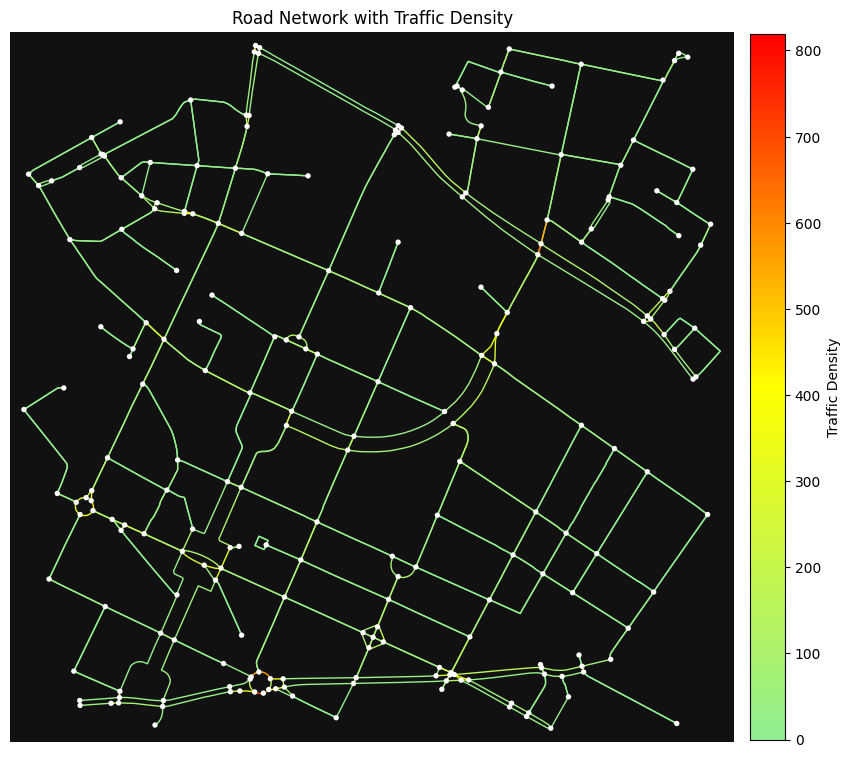

In [433]:
density_berlin = density
plot_network_with_results(g_berlin, density_berlin)
empirical_str_berlin = streets_with_highest_density(g_berlin, density_berlin)

In [423]:
counts_sf = {}
empirical_steps = 10
for _ in range(empirical_steps):
    c = traffic_empirical(address = '16 Turk, San Francisco, USA',
                             num_cars = 1000, 
                             num_steps = 100, 
                             min_car_limit = 100)
    counts_sf = {key: counts_sf.get(key, 0) + c.get(key, 0) for key in set(counts_sf) | set(c)}

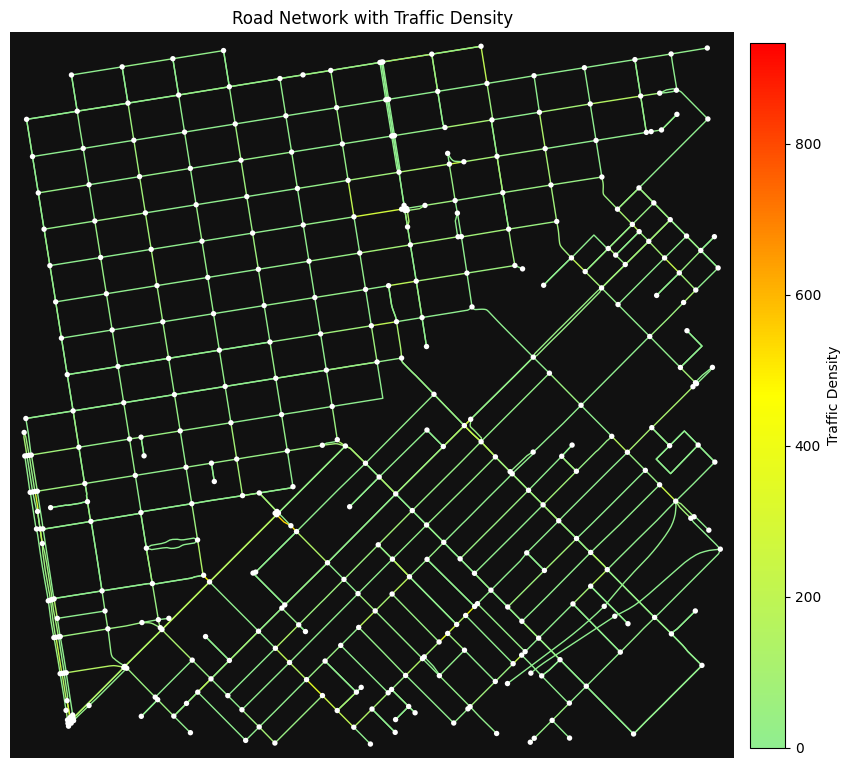

In [424]:
plot_network_with_results(g_sf, counts_sf)
empirical_str_sf = streets_with_highest_density(g_sf, counts_sf)

## Results comparison 

In [442]:
def normalize_dict_values(dictionary):
    """
    Normalize the values of a dictionary to the range [0, 1].

    Input:
        dictionary (dict): a dictionary which values to normalise.

    Output:
        normalized_dict (dict): a new dictionary with normalized values.
    """
    #get the minimum and maximum values in the dictionary
    min_value = min(dictionary.values())
    max_value = max(dictionary.values())

    #normalize each value in the dictionary
    normalized_dict = {key: (value - min_value) / (max_value - min_value) for key, value in dictionary.items()}

    return normalized_dict

In [448]:
norm_berlin = normalize_dict_values(density_berlin)

Median of the normalized empirical results for Berlin is: 0.0485511414102353
Mean (normalized): 0.1131173655953089
95% Confidence Interval (normalized): (0.09901590548538639, 0.1272188257052314)


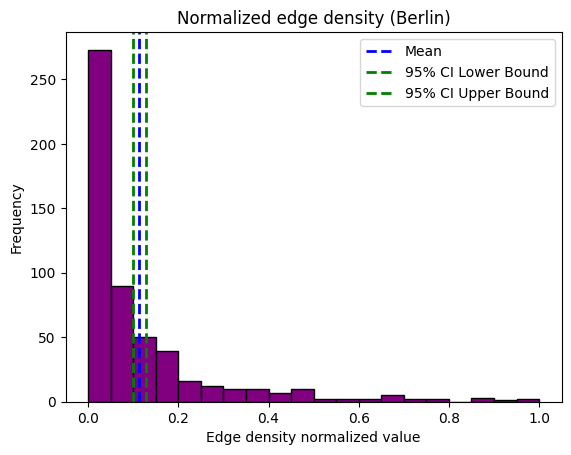

In [462]:
mean_data, lower_bound, upper_bound = confidence_interval(list(norm_berlin.values()))
print(f'Median of the normalized empirical results for Berlin is: {np.median(list(norm_berlin.values()))}')
print(f"Mean (normalized): {mean_data}")
print(f"95% Confidence Interval (normalized): ({lower_bound}, {upper_bound})")
plt.hist(norm_berlin.values(),  bins = 20, color = 'purple', edgecolor='black')
plt.title(f'Normalized edge density (Berlin)')
plt.xlabel('Edge density normalized value')
plt.ylabel('Frequency')
plt.axvline(mean_data, color='blue', linestyle='dashed', linewidth=2, label='Mean')
plt.axvline(lower_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Lower Bound')
plt.axvline(upper_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Upper Bound')
plt.legend()
plt.show()

In [454]:
norm_sf = normalize_dict_values(counts_sf)

Median of the normlaised empirical results for San Francisco is: 0.020523217920353366
Mean (normlaised): 0.07339255972338082
95% Confidence Interval (normlaized): (0.06390549100398615, 0.0828796284427755)


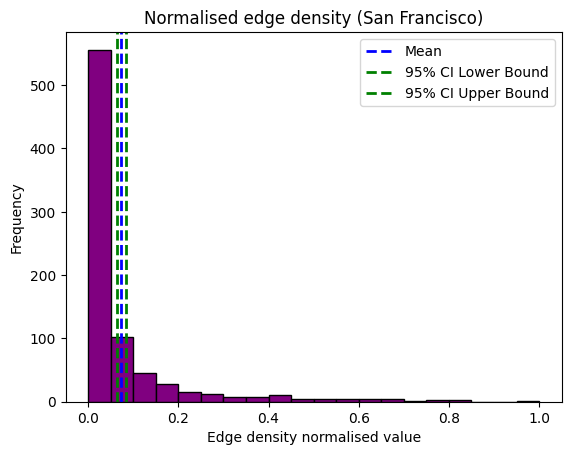

In [464]:
mean_data, lower_bound, upper_bound = confidence_interval(list(norm_sf.values()))
print(f'Median of the normlaised empirical results for San Francisco is: {np.median(list(norm_sf.values()))}')
print(f"Mean (normlaised): {mean_data}")
print(f"95% Confidence Interval (normlaized): ({lower_bound}, {upper_bound})")
plt.hist(norm_sf.values(),  bins = 20, color = 'purple', edgecolor='black')
plt.title(f'Normalised edge density (San Francisco)')
plt.xlabel('Edge density normalised value')
plt.ylabel('Frequency')
plt.axvline(mean_data, color='blue', linestyle='dashed', linewidth=2, label='Mean')
plt.axvline(lower_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Lower Bound')
plt.axvline(upper_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Upper Bound')
plt.legend()
plt.show()

In [458]:
norm_btw_b = normalize_dict_values(betweenness_values_b)
norm_btw_sf = normalize_dict_values(betweenness_values_sf)

Median of the normalised theoretical results for Berlin is: 0.10376216646354376
Mean (normalised): 0.1766068634516365
95% Confidence Interval (normalized): (0.1604702777722388, 0.19274344913103422)


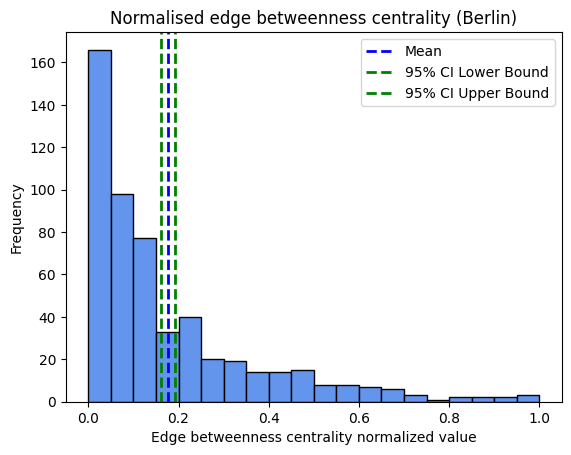

In [460]:
mean_data, lower_bound, upper_bound = confidence_interval(list(norm_btw_b.values()))
print(f'Median of the normalised theoretical results for Berlin is: {np.median(list(norm_btw_b.values()))}')
print(f"Mean (normalised): {mean_data}")
print(f"95% Confidence Interval (normalized): ({lower_bound}, {upper_bound})")
plt.hist(norm_btw_b.values(),  bins = 20, color = 'cornflowerblue', edgecolor='black')
plt.title(f'Normalised edge betweenness centrality (Berlin)')
plt.xlabel('Edge betweenness centrality normalized value')
plt.ylabel('Frequency')
plt.axvline(mean_data, color='blue', linestyle='dashed', linewidth=2, label='Mean')
plt.axvline(lower_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Lower Bound')
plt.axvline(upper_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Upper Bound')
plt.legend()
plt.show()

Median of the normalised theoretical results for San Francisco is: 0.11203732468307348
Mean (normalised): 0.17055909874723707
95% Confidence Interval (normalized): (0.15850725168960975, 0.1826109458048644)


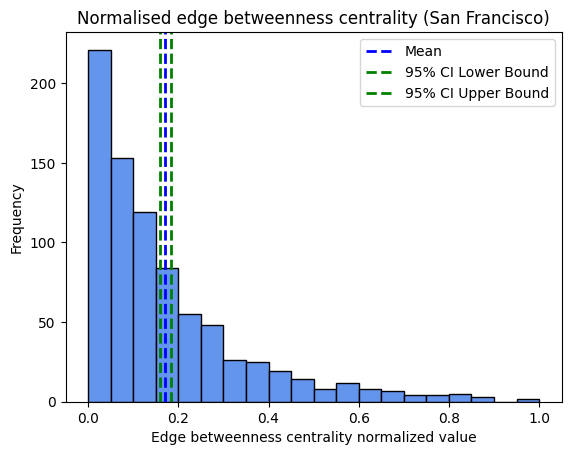

In [461]:
mean_data, lower_bound, upper_bound = confidence_interval(list(norm_btw_sf.values()))
print(f'Median of the normalised theoretical results for San Francisco is: {np.median(list(norm_btw_sf.values()))}')
print(f"Mean (normalised): {mean_data}")
print(f"95% Confidence Interval (normalized): ({lower_bound}, {upper_bound})")
plt.hist(norm_btw_sf.values(),  bins = 20, color = 'cornflowerblue', edgecolor='black')
plt.title(f'Normalised edge betweenness centrality (San Francisco)')
plt.xlabel('Edge betweenness centrality normalized value')
plt.ylabel('Frequency')
plt.axvline(mean_data, color='blue', linestyle='dashed', linewidth=2, label='Mean')
plt.axvline(lower_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Lower Bound')
plt.axvline(upper_bound, color='green', linestyle='dashed', linewidth=2, label='95% CI Upper Bound')
plt.legend()
plt.show()

In [486]:
#calculate differences between theoretical and empirical results 
errors_sf = []
for key in norm_btw_sf:
    d = norm_btw_sf[key] - norm_sf[key]
    errors_sf.append(d)
    

In [487]:
errors_berlin = []
for key in norm_btw_b:
    d = norm_btw_b[key] - norm_berlin[key]
    errors_berlin.append(d)

the total sum of errors for Berlin is 34.157349846704236
the total sum of errors for San Francisco is 79.38506238249049


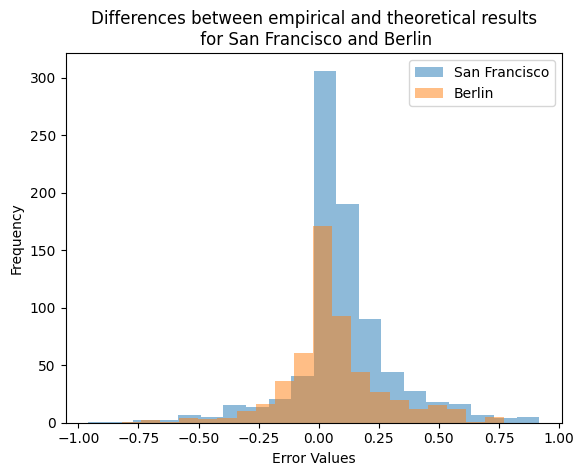

In [489]:
plt.hist(errors_sf, bins=20, alpha=0.5, label='San Francisco')
plt.hist(errors_berlin, bins=20, alpha=0.5, label='Berlin')
plt.xlabel('Error Values')
plt.ylabel('Frequency')
plt.title('Differences between empirical and theoretical results\n for San Francisco and Berlin')
plt.legend()

print(f'the total sum of errors for Berlin is {sum(errors_berlin)}')
print(f'the total sum of errors for San Francisco is {sum(errors_sf)}')
